# Problema

Transformar imagens no estilo artistico dos Simpsons

Vou seguir a linha do CycleGAN, pois nao encontro datasets "aos pares" para o Pix2Pix, e acho muito mais interessante o facto de as ser possivel nao usar dados pareados. 

# Import

In [1]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F

# para nao deixar o pc suspender enquanto treino os modelos
import subprocess
subprocess.run("killall swayidle", shell=True, capture_output=True, text=True)


CompletedProcess(args='killall swayidle', returncode=1, stdout='', stderr='swayidle: no process found\n')

# Classes

### Image loader

In [2]:
class ImageDataset(Dataset):
    def __init__(self, human_dir, simpsons_dir, transform=None, max_images=None):
        self.human_dir = human_dir
        self.simpsons_dir = simpsons_dir
        self.transform = transform

        self.human_images_path = [os.path.join(human_dir, f) for f in os.listdir(human_dir) if f.endswith(('.jpg', '.png', '.JPG', '.jpeg'))]
        self.simpsons_images_path = [os.path.join(simpsons_dir, f) for f in os.listdir(simpsons_dir) if f.endswith(('.jpg', '.png', '.JPG', '.jpeg'))]

        # use the least amount of images common between both datasets, also allow overloading this
        self.size = min(len(self.human_images_path), len(self.simpsons_images_path))
        if max_images:
            self.size = min(self.size, max_images)

        # 10k images should fit in memory, otherwise training is slower
        # idk if DataLoader already preloads things so I'll do it manually
        human_images = []
        simpsons_images = []
        print("Preloading images")
        for i in range(self.size):
            try:
                if i % (self.size // 10) == 0:
                    percentage = (i / self.size) * 100
                    print(f"Progress: {percentage:.0f}%")
                human_img = Image.open(self.human_images_path[i]).convert('RGB')
                simpsons_img = Image.open(self.simpsons_images_path[i]).convert('RGB')
                human_images.append(human_img)
                simpsons_images.append(simpsons_img)
            except Exception as e:
                print(f"Error at image {i}: {e}, skipping")
                self.size -= 1 # ???
                continue

        self.human_images = human_images
        self.simpsons_images = simpsons_images



    def __len__(self):
        return self.size

    # open imgs as rgb, transform if needed. transform is dynamic so it's easier to randomize
    def __getitem__(self, idx):
        human_img = self.human_images[idx]
        simpsons_img = self.simpsons_images[idx]
        if self.transform:
            human_img = self.transform(human_img)
            simpsons_img = self.transform(simpsons_img)
        return {'human': human_img, 'simpsons': simpsons_img}


### Generators

In [3]:
# Define ResNet block for the generator
class ResNetBlock(nn.Module):
    def __init__(self, dim):
        super(ResNetBlock, self).__init__()
        self.conv_block = nn.Sequential(
            nn.Conv2d(dim, dim, kernel_size=3, stride=1, padding=1, bias=False),
            nn.InstanceNorm2d(dim),
            nn.ReLU(True),
            nn.Conv2d(dim, dim, kernel_size=3, stride=1, padding=1, bias=False),
            nn.InstanceNorm2d(dim)
        )

    def forward(self, x):
        return x + self.conv_block(x)  # Residual connection

# Define Generator (ResNet-based encoder-decoder)
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=7, stride=1, padding=3, bias=False),
            nn.InstanceNorm2d(64),
            nn.ReLU(True),
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1, bias=False),
            nn.InstanceNorm2d(128),
            nn.ReLU(True),
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1, bias=False),
            nn.InstanceNorm2d(256),
            nn.ReLU(True)
        )
        self.res_blocks = nn.Sequential(*[ResNetBlock(256) for _ in range(6)])
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1, bias=False),
            nn.InstanceNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1, bias=False),
            nn.InstanceNorm2d(64),
            nn.ReLU(True),
            nn.Conv2d(64, 3, kernel_size=7, stride=1, padding=3),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.res_blocks(x)
        x = self.decoder(x)
        return x
    
# stolen from PatchGAN https://paperswithcode.com/method/patchgan but changed to 3 channels since 6 is for pix2pix, where 2 images are concatenated. Doesn't make sense to use it here, but why not
# can't use the discriminator since it requires a label and paired images
class GeneratorPatchGAN(nn.Module):
    # initializers
    def __init__(self, d=64):
        super(GeneratorPatchGAN, self).__init__()
        self.conv1 = nn.Conv2d(3, d, 4, 2, 1)
        self.conv2 = nn.Conv2d(d, d * 2, 4, 2, 1)
        self.conv2_bn = nn.BatchNorm2d(d * 2)
        self.conv3 = nn.Conv2d(d * 2, d * 4, 4, 2, 1)
        self.conv3_bn = nn.BatchNorm2d(d * 4)
        self.conv4 = nn.Conv2d(d * 4, d * 8, 4, 2, 1)
        self.conv4_bn = nn.BatchNorm2d(d * 8)
        self.conv5 = nn.Conv2d(d * 8, d * 8, 4, 2, 1)
        self.conv5_bn = nn.BatchNorm2d(d * 8)
        self.conv6 = nn.Conv2d(d * 8, d * 8, 4, 2, 1)
        self.conv6_bn = nn.BatchNorm2d(d * 8)
        self.conv7 = nn.Conv2d(d * 8, d * 8, 4, 2, 1)
        self.conv7_bn = nn.BatchNorm2d(d * 8)
        self.conv8 = nn.Conv2d(d * 8, d * 8, 4, 2, 1)
        # self.conv8_bn = nn.BatchNorm2d(d * 8)

        # Unet decoder
        self.deconv1 = nn.ConvTranspose2d(d * 8, d * 8, 4, 2, 1)
        self.deconv1_bn = nn.BatchNorm2d(d * 8)
        self.deconv2 = nn.ConvTranspose2d(d * 8 * 2, d * 8, 4, 2, 1)
        self.deconv2_bn = nn.BatchNorm2d(d * 8)
        self.deconv3 = nn.ConvTranspose2d(d * 8 * 2, d * 8, 4, 2, 1)
        self.deconv3_bn = nn.BatchNorm2d(d * 8)
        self.deconv4 = nn.ConvTranspose2d(d * 8 * 2, d * 8, 4, 2, 1)
        self.deconv4_bn = nn.BatchNorm2d(d * 8)
        self.deconv5 = nn.ConvTranspose2d(d * 8 * 2, d * 4, 4, 2, 1)
        self.deconv5_bn = nn.BatchNorm2d(d * 4)
        self.deconv6 = nn.ConvTranspose2d(d * 4 * 2, d * 2, 4, 2, 1)
        self.deconv6_bn = nn.BatchNorm2d(d * 2)
        self.deconv7 = nn.ConvTranspose2d(d * 2 * 2, d, 4, 2, 1)
        self.deconv7_bn = nn.BatchNorm2d(d)
        self.deconv8 = nn.ConvTranspose2d(d * 2, 3, 4, 2, 1)

    def weight_init(self, mean, std):
        for m in self._modules:
            normal_init(self._modules[m], mean, std)

    def forward(self, input):
        e1 = self.conv1(input)
        e2 = self.conv2_bn(self.conv2(F.leaky_relu(e1, 0.2)))
        e3 = self.conv3_bn(self.conv3(F.leaky_relu(e2, 0.2)))
        e4 = self.conv4_bn(self.conv4(F.leaky_relu(e3, 0.2)))
        e5 = self.conv5_bn(self.conv5(F.leaky_relu(e4, 0.2)))
        e6 = self.conv6_bn(self.conv6(F.leaky_relu(e5, 0.2)))
        e7 = self.conv7_bn(self.conv7(F.leaky_relu(e6, 0.2)))
        e8 = self.conv8(F.leaky_relu(e7, 0.2))
        # e8 = self.conv8_bn(self.conv8(F.leaky_relu(e7, 0.2)))
        d1 = F.dropout(self.deconv1_bn(self.deconv1(F.relu(e8))), 0.5, training=True)
        d1 = torch.cat([d1, e7], 1)
        d2 = F.dropout(self.deconv2_bn(self.deconv2(F.relu(d1))), 0.5, training=True)
        d2 = torch.cat([d2, e6], 1)
        d3 = F.dropout(self.deconv3_bn(self.deconv3(F.relu(d2))), 0.5, training=True)
        d3 = torch.cat([d3, e5], 1)
        d4 = self.deconv4_bn(self.deconv4(F.relu(d3)))
        # d4 = F.dropout(self.deconv4_bn(self.deconv4(F.relu(d3))), 0.5)
        d4 = torch.cat([d4, e4], 1)
        d5 = self.deconv5_bn(self.deconv5(F.relu(d4)))
        d5 = torch.cat([d5, e3], 1)
        d6 = self.deconv6_bn(self.deconv6(F.relu(d5)))
        d6 = torch.cat([d6, e2], 1)
        d7 = self.deconv7_bn(self.deconv7(F.relu(d6)))
        d7 = torch.cat([d7, e1], 1)
        d8 = self.deconv8(F.relu(d7))
        o = F.tanh(d8)

        return o

def normal_init(m, mean, std):
    if isinstance(m, nn.ConvTranspose2d) or isinstance(m, nn.Conv2d):
        m.weight.data.normal_(mean, std)
        m.bias.data.zero_()


### Discriminators

In [4]:
# inspired from CycleGAN https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix/
class DiscriminatorCycleGAN(nn.Module):
    def __init__(self):
        super(DiscriminatorCycleGAN, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.InstanceNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.InstanceNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 512, kernel_size=4, stride=1, padding=1, bias=False),
            nn.InstanceNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=1)
        )

    def forward(self, x):
        return self.model(x)

### Training

Data

In [5]:
# models and data are kept as global vars to be reused and avoid a memory leak issue

transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

human_dir = 'dataset/humans'
simpsons_dir = 'dataset/simpsons'
dataset = ImageDataset(human_dir, simpsons_dir, transform=transform, max_images=500)
dataloader = DataLoader(dataset, batch_size=1, shuffle=True)

Preloading images
Progress: 0%
Progress: 10%
Progress: 20%
Progress: 30%
Progress: 40%
Progress: 50%
Progress: 60%
Progress: 70%
Progress: 80%
Progress: 90%


Models

In [7]:

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

gen_H2S = Generator().to(device)  # Human to Simpsons
gen_S2H = Generator().to(device)  # Simpsons to Human
disc_H = DiscriminatorCycleGAN().to(device)  # Discriminator for human images
disc_S = DiscriminatorCycleGAN().to(device)  # Discriminator for Simpsons images

Train

In [8]:
def train(epochs=100, lr=0.0002, save_dir='output'):
    
    # Losses
    criterion_GAN = nn.MSELoss()
    criterion_cycle = nn.L1Loss()
    criterion_identity = nn.L1Loss()
    
    # Optimizers
    optimizer_G = optim.Adam(list(gen_H2S.parameters()) + list(gen_S2H.parameters()), lr=lr, betas=(0.5, 0.999))
    optimizer_D_H = optim.Adam(disc_H.parameters(), lr=lr, betas=(0.5, 0.999))
    optimizer_D_S = optim.Adam(disc_S.parameters(), lr=lr, betas=(0.5, 0.999))
    
    os.makedirs(save_dir, exist_ok=True)
    
    for epoch in range(epochs):
        for i, data in enumerate(dataloader):
            real_H = data['human'].to(device)
            real_S = data['simpsons'].to(device)
            
            # Ground truth for discriminators
            real_label = torch.ones(real_H.size(0), 1, 30, 30).to(device)  # PatchGAN output size
            fake_label = torch.zeros(real_H.size(0), 1, 30, 30).to(device)
            
            ########## train generators ##########
            optimizer_G.zero_grad()
            
            # Identity loss
            identity_H = gen_S2H(real_H)
            identity_S = gen_H2S(real_S)
            loss_identity = (criterion_identity(identity_H, real_H) + criterion_identity(identity_S, real_S)) * 5.0
            
            # GAN loss
            fake_S = gen_H2S(real_H)
            pred_fake_S = disc_S(fake_S)
            loss_GAN_H2S = criterion_GAN(pred_fake_S, real_label)
            
            fake_H = gen_S2H(real_S)
            pred_fake_H = disc_H(fake_H)
            loss_GAN_S2H = criterion_GAN(pred_fake_H, real_label)
            
            # Cycle consistency loss
            rec_H = gen_S2H(fake_S)
            rec_S = gen_H2S(fake_H)
            loss_cycle = (criterion_cycle(rec_H, real_H) + criterion_cycle(rec_S, real_S)) * 10.0
            
            # Total generator loss
            loss_G = loss_GAN_H2S + loss_GAN_S2H + loss_cycle + loss_identity
            loss_G.backward()
            optimizer_G.step()
            
            ########## train discriminators ##########
            # human
            optimizer_D_H.zero_grad()
            pred_real_H = disc_H(real_H)
            loss_D_real_H = criterion_GAN(pred_real_H, real_label)
            pred_fake_H = disc_H(fake_H.detach())
            loss_D_fake_H = criterion_GAN(pred_fake_H, fake_label)
            loss_D_H = (loss_D_real_H + loss_D_fake_H) * 0.5
            loss_D_H.backward()
            optimizer_D_H.step()
            
            # simpson
            optimizer_D_S.zero_grad()
            pred_real_S = disc_S(real_S)
            loss_D_real_S = criterion_GAN(pred_real_S, real_label)
            pred_fake_S = disc_S(fake_S.detach())
            loss_D_fake_S = criterion_GAN(pred_fake_S, fake_label)
            loss_D_S = (loss_D_real_S + loss_D_fake_S) * 0.5
            loss_D_S.backward()
            optimizer_D_S.step()
            
            # progress at the start of the epoch
            if i % 100 == 0:
                print(f"Epoch [{epoch+1}/{epochs}] Batch [{i}/{len(dataloader)}] "
                      f"Loss_G: {loss_G.item():.4f} Loss_D_H: {loss_D_H.item():.4f} Loss_D_S: {loss_D_S.item():.4f}")
            
            # example image every 1000 batches just because
            # TODO: why is this only writing at epoch 0?????
            if i % 1000 == 0:
                with torch.no_grad():
                    fake_S = gen_H2S(real_H)
                    img = fake_S[0].cpu().permute(1, 2, 0).numpy() * 0.5 + 0.5  # Denormalize
                    plt.imsave(os.path.join(save_dir, f'epoch_{epoch+1}_batch_{i}_fake_simpsons.png'), img)
    
        # save model every 5 epochs
        if (epoch + 1) % 5 == 0:
            torch.save(gen_H2S.state_dict(), os.path.join(save_dir, f'gen_H2S.pth'))
            torch.save(gen_S2H.state_dict(), os.path.join(save_dir, f'gen_S2H.pth'))
            torch.save(disc_H.state_dict(), os.path.join(save_dir, f'disc_H.pth'))
            torch.save(disc_S.state_dict(), os.path.join(save_dir, f'disc_S.pth'))

train(epochs=5, lr=0.0002, save_dir='output')

Epoch [1/5] Batch [0/500] Loss_G: 18.8086 Loss_D_H: 0.9504 Loss_D_S: 0.7035
Epoch [1/5] Batch [100/500] Loss_G: 7.3509 Loss_D_H: 0.1717 Loss_D_S: 0.2174
Epoch [1/5] Batch [200/500] Loss_G: 9.8163 Loss_D_H: 0.1909 Loss_D_S: 0.1616
Epoch [1/5] Batch [300/500] Loss_G: 6.1984 Loss_D_H: 0.1688 Loss_D_S: 0.1850
Epoch [1/5] Batch [400/500] Loss_G: 6.9327 Loss_D_H: 0.2789 Loss_D_S: 0.1882
Epoch [2/5] Batch [0/500] Loss_G: 6.2160 Loss_D_H: 0.1085 Loss_D_S: 0.0878
Epoch [2/5] Batch [100/500] Loss_G: 4.7937 Loss_D_H: 0.4183 Loss_D_S: 0.2765
Epoch [2/5] Batch [200/500] Loss_G: 6.3754 Loss_D_H: 0.3099 Loss_D_S: 0.3929
Epoch [2/5] Batch [300/500] Loss_G: 6.2046 Loss_D_H: 0.1079 Loss_D_S: 0.1885
Epoch [2/5] Batch [400/500] Loss_G: 7.3282 Loss_D_H: 0.1390 Loss_D_S: 0.2672
Epoch [3/5] Batch [0/500] Loss_G: 6.0155 Loss_D_H: 0.1936 Loss_D_S: 0.2668
Epoch [3/5] Batch [100/500] Loss_G: 7.5224 Loss_D_H: 0.1571 Loss_D_S: 0.1394
Epoch [3/5] Batch [200/500] Loss_G: 5.9268 Loss_D_H: 0.1131 Loss_D_S: 0.0796
Epoc

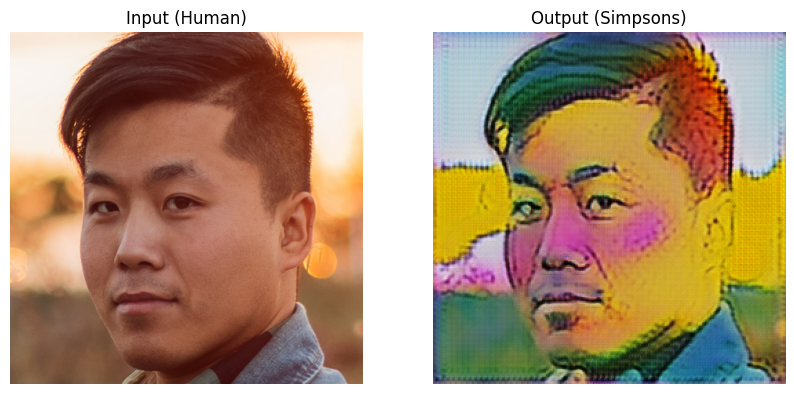

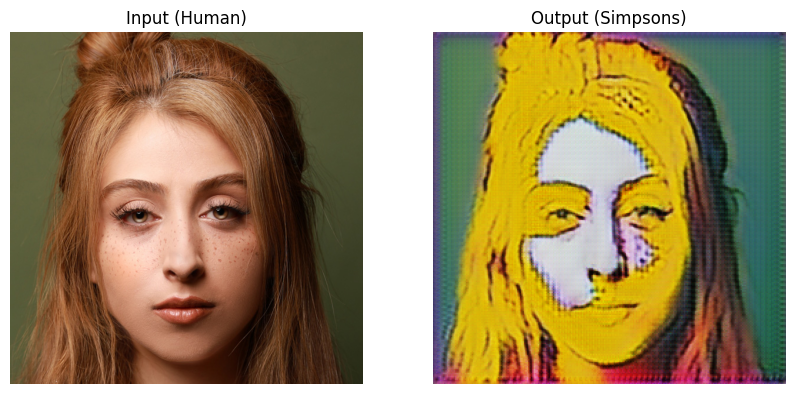

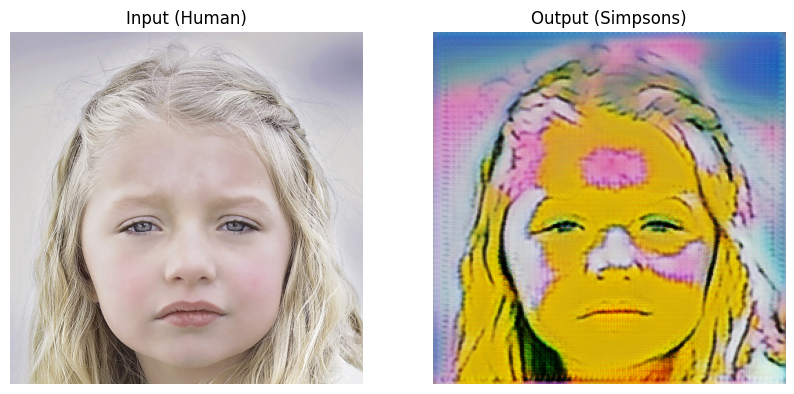

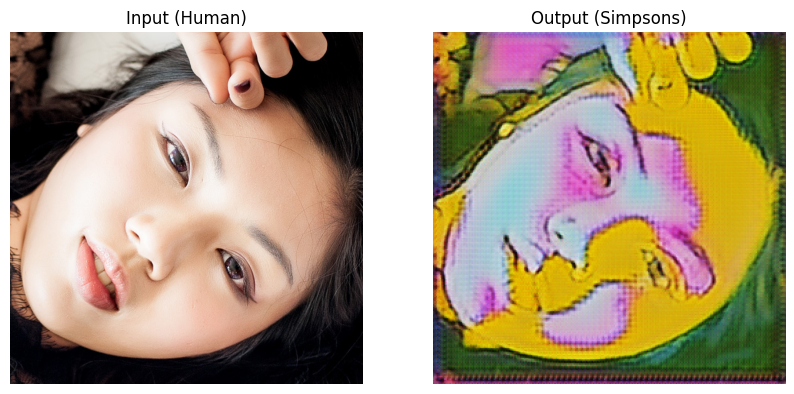

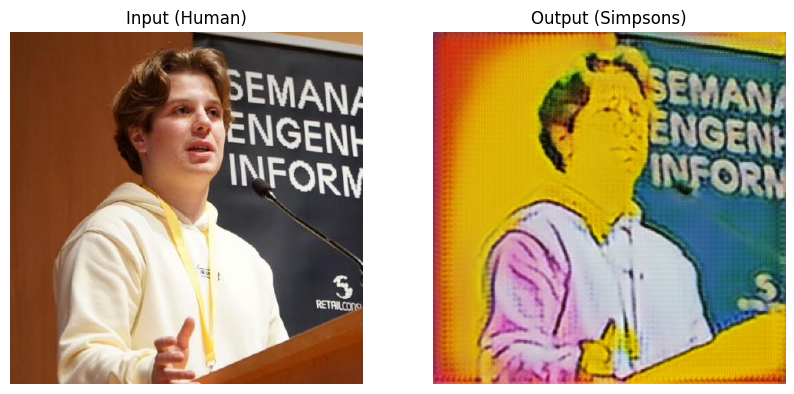

...

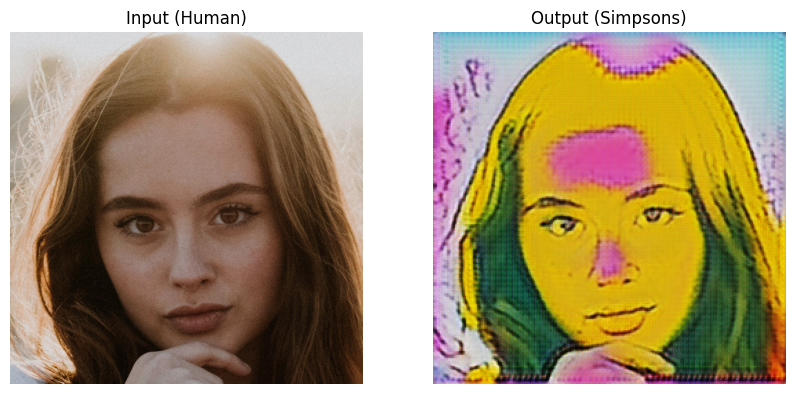

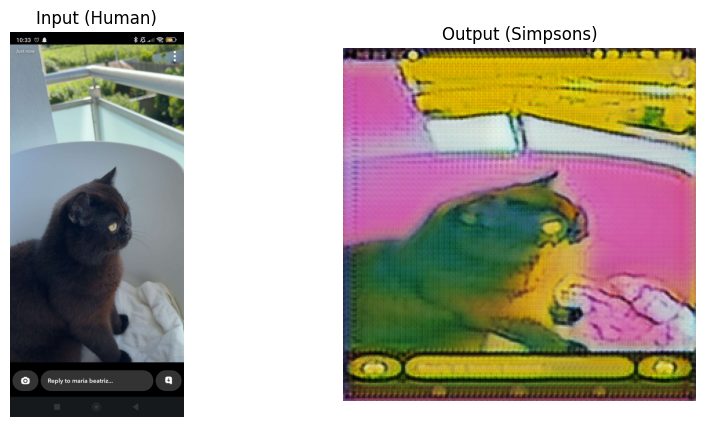

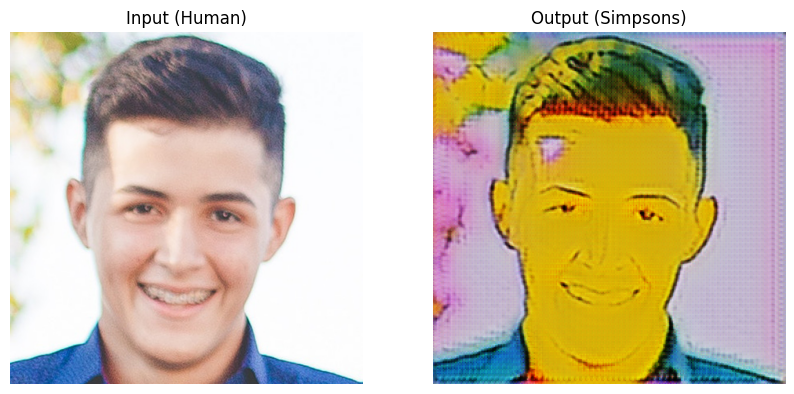

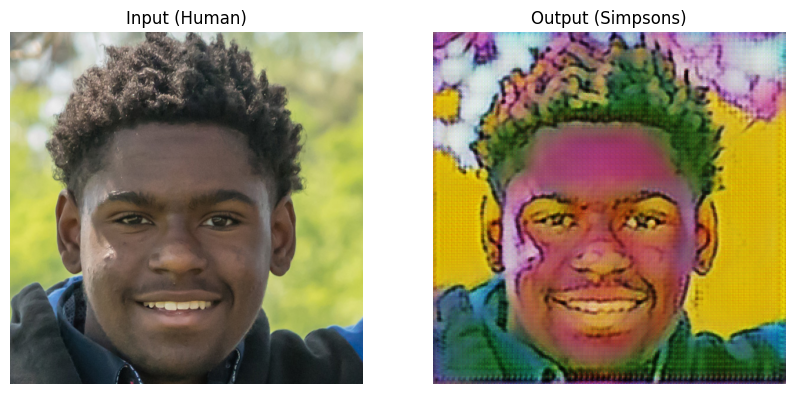

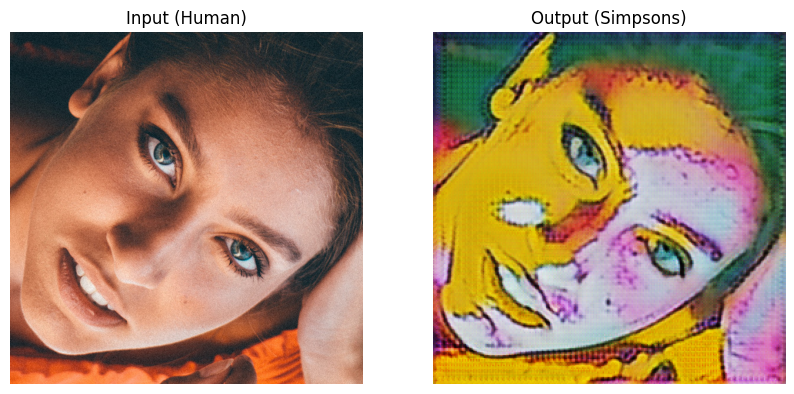

In [9]:
def infer_cyclegan(input_dir, output_dir, model_path, device='cuda' if torch.cuda.is_available() else 'cpu'):
    # Create output directory
    os.makedirs(output_dir, exist_ok=True)
    
    # Define image transforms (must match training)
    transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])
    
    # Load generator model
    gen_H2S = Generator().to(device)
    gen_H2S.load_state_dict(torch.load(model_path, map_location=device))
    gen_H2S.eval()
    
    # Get list of input images
    input_images = [os.path.join(input_dir, f) for f in os.listdir(input_dir) if f.endswith(('.jpg', '.png'))]
    
    # Process each image
    for img_path in input_images:
        # Load and preprocess image
        img = Image.open(img_path).convert('RGB')
        img_tensor = transform(img).unsqueeze(0).to(device)  # Add batch dimension
        
        # Generate Simpsons-style image
        with torch.no_grad():
            fake_simpsons = gen_H2S(img_tensor)
        
        # Denormalize and convert to PIL image
        fake_simpsons = fake_simpsons.squeeze(0).cpu().permute(1, 2, 0).numpy() * 0.5 + 0.5
        fake_simpsons = (fake_simpsons * 255).astype(np.uint8)
        output_img = Image.fromarray(fake_simpsons)
        
        # # Save output
        # output_path = os.path.join(output_dir, f"simpsons_{os.path.basename(img_path)}")
        # output_img.save(output_path)
        # print(f"Saved: {output_path}")
        
        # Optional: Display input and output (comment out if not needed)
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.title("Input (Human)")
        plt.imshow(img)
        plt.axis('off')
        plt.subplot(1, 2, 2)
        plt.title("Output (Simpsons)")
        plt.imshow(output_img)
        plt.axis('off')
        plt.show()



input_dir = 'dataset/input_humans'  # Directory with test human images
output_dir = 'results'     # Directory to save Simpsons-style images

infer_cyclegan(input_dir, output_dir, 'output/gen_H2S.pth')